In [2]:
# pip install G4X-helpers
import g4x_helpers as g4h
g4h.__version__

'0.0.3'

G4X_output @ /mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02
Sample: D02 of G07-127, FC3
imaged area: (4.76 x 6.00) mm

Transcript panel with 362 genes	[ACKR1, ACKR4, ACTA2, ADGRE5, ADGRF5 ... ]
Protein panel with 20 proteins	[ATPase, CD11c, CD20, CD3, CD31 ... ]



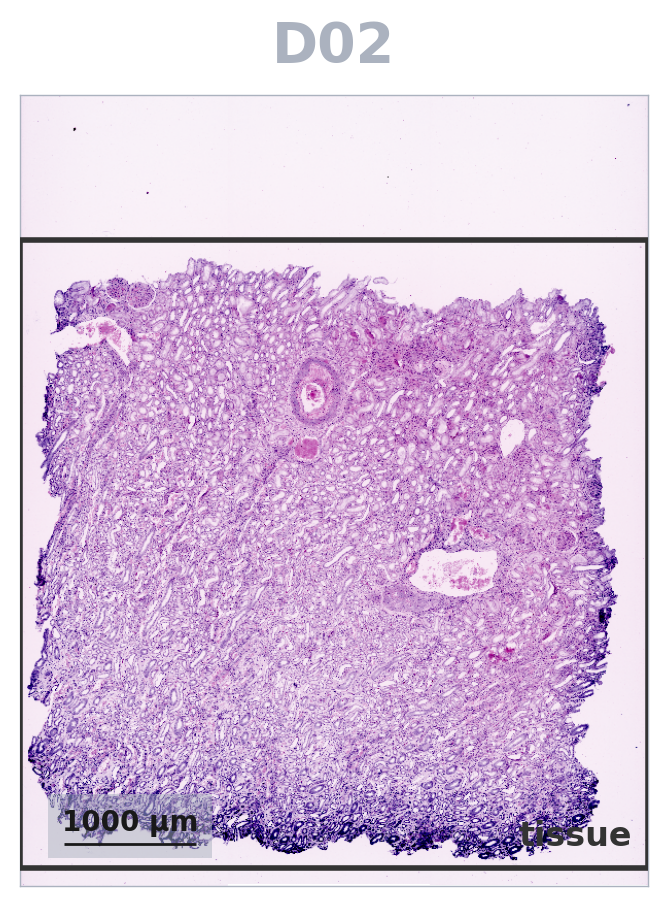

In [2]:
run_base = '/mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02'
sample = g4h.G4Xoutput(run_base=run_base)

print(sample)
sample.thumb(size=4.5, view='data', scale=1, show_tissue_bounds=True)

In [8]:
import numpy as np

def map_categories(adata, cell_label='cell_label', obs_key='leiden'):
    series = adata.obs[obs_key].copy()

    if series.dtype.name != 'category':
        # print("Casting series to categorical")
        series = series.astype('category')

    cat_mapping = {category: idx for idx, category in enumerate(series.cat.categories)}

    label_to_group = adata.obs[[cell_label, obs_key]].set_index(cell_label).to_dict()[obs_key]
    label_to_group = {key: cat_mapping[value] for key, value in label_to_group.items()}

    return label_to_group, cat_mapping

In [9]:
mask = sample.load_segmentation()
adata = sample.load_adata()

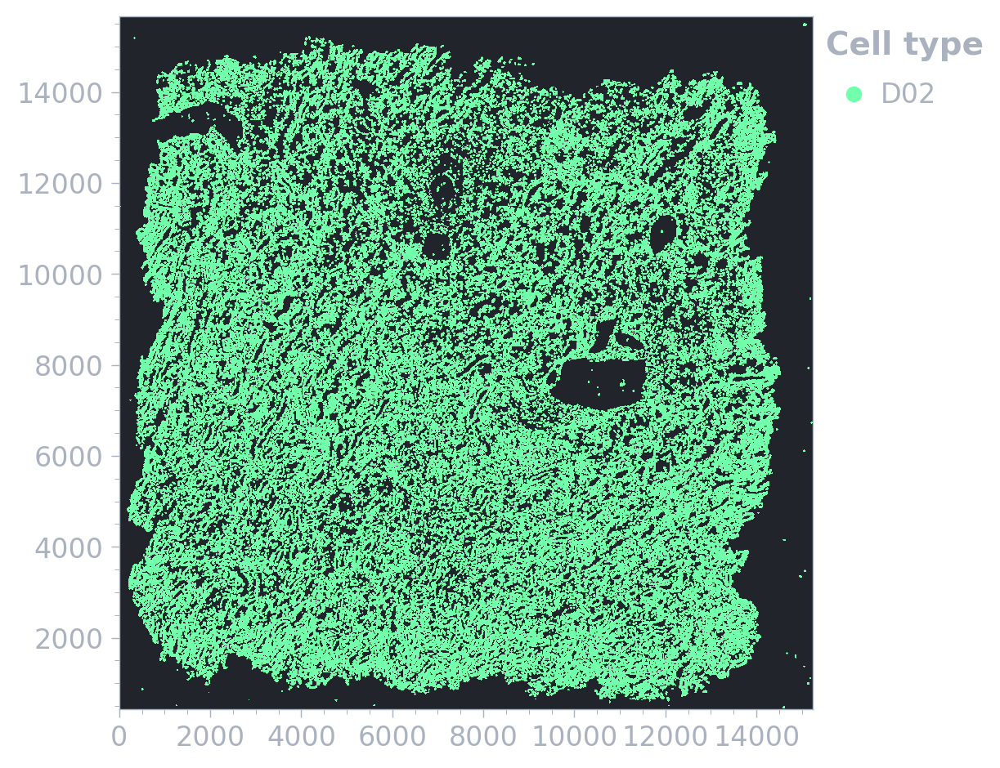

In [10]:
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm
from matplotlib.colors import ListedColormap

ax = g4h.pl.montage_plot(1)
downsample = 'auto'
palette = g4h.pl.set25
cell_label = 'cell_label'
cluster_key = 'sample_id'
legend_loc = 'right'
roi = sample.rois['tissue']
legend_title = 'Cell type'
breaks_size = 1000

plot_mask = roi._crop_array(mask)
plot_mask = g4h.pl.downsample_mask(plot_mask, ax=ax, downsample=downsample)

adata.obs['cell_label'] = adata.obs['cell_id'].str.split('-').str[1]

label_to_group, cat_mapping = map_categories(adata, cell_label=cell_label, obs_key=cluster_key)
plot_mask = np.vectorize(lambda x: label_to_group.get(str(x), -1))(plot_mask)

pal = palette.copy()
# pal.insert(0, plt.rcParams.get('axes.facecolor'))
pal.insert(0, (0, 0, 0, 0))
cmap = ListedColormap(pal)

# Use BoundaryNorm to force discrete mapping
bounds = np.arange(-1, len(pal))
norm = BoundaryNorm(bounds, cmap.N)

ax.imshow(plot_mask, cmap=cmap, norm=norm, interpolation='nearest', origin='lower', extent=roi.extent, zorder=2)
#ax.imshow(plot_mask, origin='lower', zorder=2, extent=roi.extent)

if legend_loc is not None:
    legend_labels = adata.obs[cluster_key].astype('category').cat.categories
    g4h.pl._add_legend(ax, categories=legend_labels, palette=pal[1:], title=legend_title, loc=legend_loc)


# if title is not None:
#     ax.set_title(title)

plt.show()


In [ ]:
ax = g4h.pl.montage_plot(1)

# plot_masks(adata, masks, ax=ax, title='clusters: spatial', cluster_key=f'leiden_0.400', legend_loc=None, lims=lims)

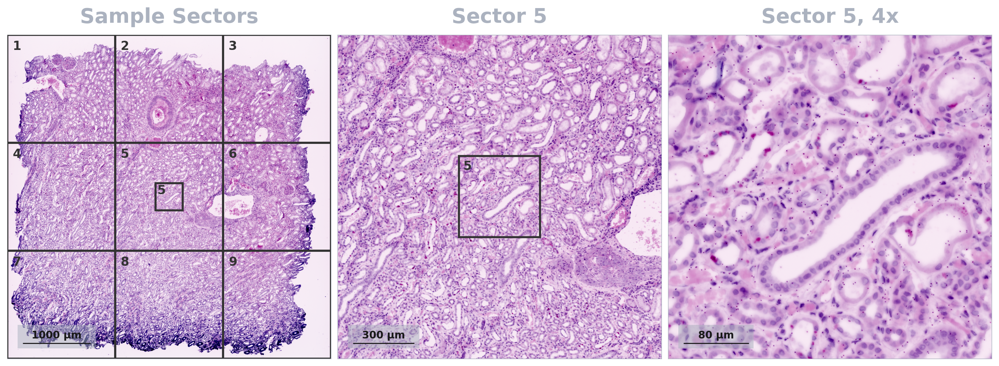

In [11]:
import matplotlib.pyplot as plt

axs = g4h.pl.montage_plot(3, panel_size=4.5)

rois = sample.rois['tissue'].subtile_roi(3)

for roi in rois:
    sample.add_roi(roi=roi)
    roi.add_to_plot(ax=axs[0], color='0.2')

sample.plot_signal(signal='h_and_e', view='tissue', scale=1, thumbnail=False, ax=axs[0])
sample.plot_signal(signal='h_and_e', view='5', scale=1, ax=axs[1], thumbnail=False)
sample.plot_signal(signal='h_and_e', view='5', scale=0.25, ax=axs[2], thumbnail=False)

rois[4].add_to_plot(ax=axs[0], color='0.2', scale=0.25)
rois[4].add_to_plot(ax=axs[1], color='0.2', scale=0.25)

axs[0].set_title('Sample Sectors')
axs[1].set_title('Sector 5')
axs[2].set_title('Sector 5, 4x')

plt.show()

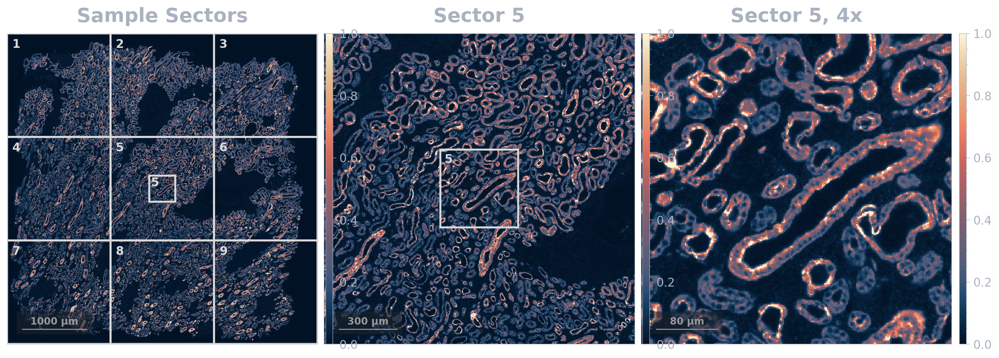

In [27]:
import matplotlib.pyplot as plt

signal = 'PanCK'

axs = g4h.pl.montage_plot(3, panel_size=4.5)

rois = sample.rois['tissue'].subtile_roi(3)
for roi in rois:
    sample.add_roi(roi=roi)
    roi.add_to_plot(ax=axs[0], color='0.85')

sample.plot_signal(signal=signal, view='tissue', scale=1, ax=axs[0], thumbnail=True)
sample.plot_signal(signal=signal, view='5', scale=1, ax=axs[1], thumbnail=True)
sample.plot_signal(signal=signal, view='5', scale=0.25, ax=axs[2], thumbnail=True)

rois[4].add_to_plot(ax=axs[0], color='0.85', scale=0.25)
rois[4].add_to_plot(ax=axs[1], color='0.85', scale=0.25)

axs[0].set_title('Sample Sectors')
axs[1].set_title('Sector 5')
axs[2].set_title('Sector 5, 4x')

plt.show()

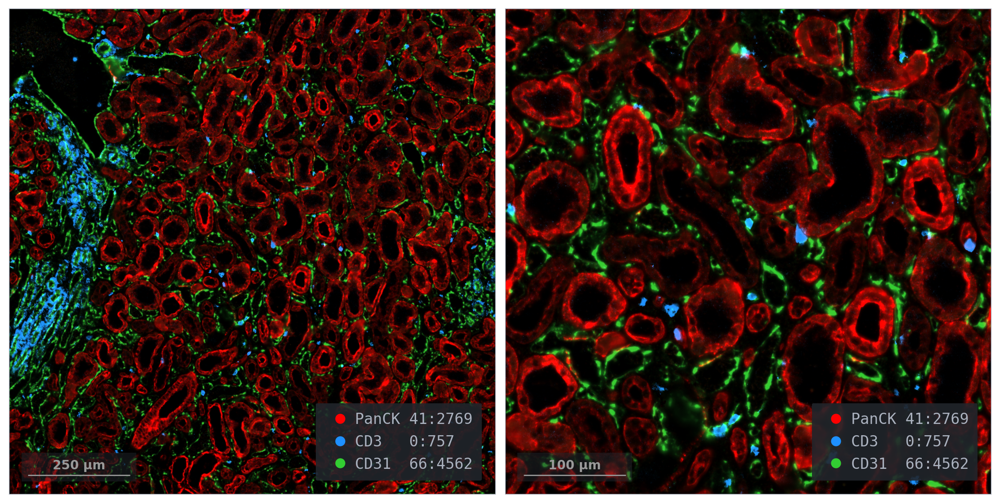

In [29]:
axs = g4h.pl.montage_plot(2, panel_size=5.5)

query=['PanCK', 'CD3', 'CD31']
colors=['red', 'dodgerblue', 'limegreen']

sample.blend_signals(query=query, colors=colors, plot=True, roi='A', scale=0.5, ax=axs[0])
sample.blend_signals(query=query, colors=colors, plot=True, roi='A', scale=0.2, ax=axs[1])


In [10]:
sample.list_content(subdir='single_cell_data')

{'dirs': [],
 'files': ['clustering_umap.csv.gz',
  'cell_by_protein.csv.gz',
  'cell_metadata.csv.gz',
  'cell_by_transcript.csv.gz',
  'dgex.csv.gz',
  'feature_matrix.h5']}

In [11]:
sample.proteins

['ATPase',
 'CD11c',
 'CD20',
 'CD3',
 'CD31',
 'CD4',
 'CD45RA',
 'CD56',
 'CD68',
 'CD8',
 'CTLA4',
 'FOXP3',
 'HLA-DR',
 'KI67',
 'MsIgG1',
 'MsIgG2a',
 'PD1',
 'PDL1',
 'PanCK',
 'aSMA']

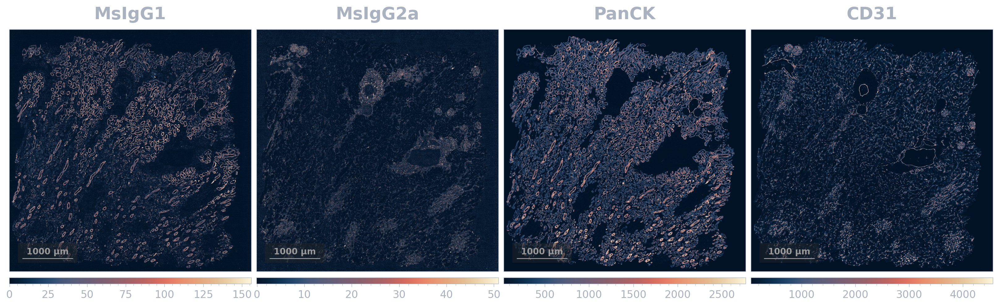

In [12]:
sample.plot_signals(signals=['MsIgG1', 'MsIgG2a', 'PanCK', 'CD31'], view='tissue', size=4, scale=1, thumbnail=False)

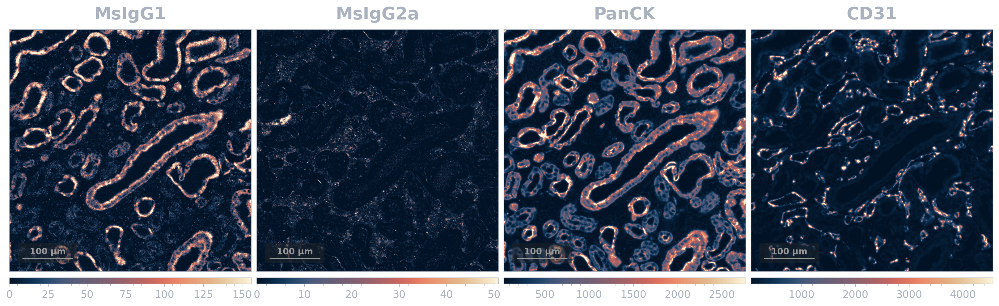

In [13]:
sample.plot_signals(signals=['MsIgG1', 'MsIgG2a', 'PanCK', 'CD31'], view='tissue', size=4, scale=0.1, thumbnail=False)

### New rois can be added and used for plotting

In [14]:
sample.add_roi(roi_name='test_roi', xlims=(2500, 7500), ylims=(2500, 7500))

/home/ubuntu/.pyenv/versions/g4x_helpers/lib/python3.10/site-packages/skimage/_shared/utils.py:445: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


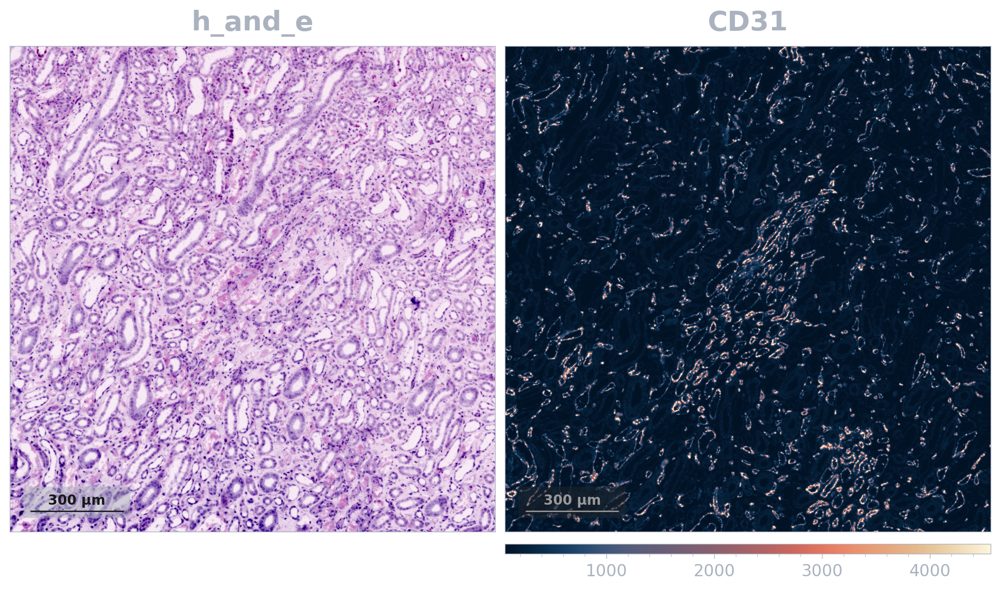

In [15]:
sample.plot_signals(signals=['h_and_e', 'CD31'], view='test_roi', size=5, scale=1, thumbnail=False)

### images will be loaded from cache if they have been previously loaded/plotted

In [17]:
img = sample.load_image('h_and_e', thumbnail=True)
img.shape

(3840, 3047, 3)

# Re-Segmentation
### vectorize the seg masks to simulate input from polygons

In [41]:
# pip install G4X-helpers
import g4x_helpers as g4h
g4h.__version__

run_base = '/mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02'
sample = g4h.G4Xoutput(run_base=run_base)

In [42]:
import g4x_helpers.segmentation as g4x_segmentation

test_mask = sample.load_segmentation(expanded=True)

# polygon_labels = g4x_segmentation._vectorize_mask(test_mask, nudge=True)
# polygon_labels.head()

In [43]:
seg_out = sample.run_base / 'custom_seg'
sample.run_g4x_segmentation(labels=test_mask, out_dir=seg_out, include_channels=['nuclear', 'eosin', 'PanCK', 'CD31'])

Extracting mask properties
Assigning transcripts to mask labels
Extracting image signals
Extracting nuclear signal...
Extracting eosin signal...
Extracting PanCK signal...
Extracting CD31 signal...
Building output data structures
Saving output files to /mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02/custom_seg


In [8]:
import g4x_helpers.segmentation as reseg

In [33]:
mask = test_mask
include_channels=['nuclear', 'eosin', 'PanCK', 'CD31']
seg_out = sample.run_base / 'custom_seg'

print('Extracting mask properties')
segmentation_props = reseg.get_mask_properties(sample, mask)

print('Assigning transcripts to mask labels')
reads_new_labels = reseg.assign_tx_to_mask_labels(sample, mask)

print('Extracting image signals')
cell_by_protein = reseg.extract_image_signals(
    sample, mask, include_channels=include_channels, exclude_channels=None
)

print('Building output data structures')
cell_metadata = reseg._make_cell_metadata(segmentation_props, cell_by_protein)
cell_by_gene = reseg._make_cell_by_gene(segmentation_props, reads_new_labels)
adata = reseg._make_adata(cell_by_gene, cell_metadata)

Extracting mask properties
Assigning transcripts to mask labels
Extracting image signals
Extracting nuclear signal...
Extracting eosin signal...
Extracting PanCK signal...
Extracting CD31 signal...
Building output data structures


/home/ubuntu/floraths/flo_dev/G4X-helpers/.venv/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [38]:
cell_metadata.drop('segmentation_label').to_pandas()

,segmentation_cell_id,area,cell_x,cell_y,nuclearstain_intensity_mean,cytoplasmicstain_intensity_mean,PanCK_intensity_mean,CD31_intensity_mean
0,D02-1,1208.0,11278.938742,15.348510,6.461093,6.461093,6.461093,6.461093
1,D02-2,1735.0,69.005764,19.633429,3.846110,3.846110,3.846110,3.846110
2,D02-3,2076.0,13024.856936,54.096339,6.550096,6.550096,6.550096,6.550096
3,D02-4,1787.0,12414.146614,60.585339,4.829323,4.829323,4.829323,4.829323
4,D02-5,2250.0,5767.357778,69.454222,5.351111,5.351111,5.351111,5.351111
...,...,...,...,...,...,...,...,...
84501,D02-84502,1030.0,10187.955340,18746.338835,29.346602,29.346602,29.346602,29.346602
84502,D02-84503,1219.0,881.896637,18864.917145,13.305168,13.305168,13.305168,13.305168
84503,D02-84504,1400.0,14761.228571,18895.794286,11.972143,11.972143,11.972143,11.972143
84504,D02-84505,2533.0,14768.063561,18934.529807,6.229372,6.229372,6.229372,6.229372


In [ ]:
import anndata as ad
import scanpy as sc

X = cell_by_gene.drop('segmentation_cell_id').to_numpy()

#adata = ad.AnnData(X=X, obs=cell_metadata.drop('segmentation_label').to_pandas())

obs_df = cell_metadata.drop('segmentation_label').to_pandas()
obs_df.index = obs_df.index.astype(str)

adata = ad.AnnData(X=X, obs=obs_df)

# adata.var['gene_id'] = cell_by_gene.columns[1:]
# adata.var['modality'] = 'tx'

# sc.pp.calculate_qc_metrics(adata, inplace=True, percent_top=None)



In [32]:
adata

AnnData object with n_obs × n_vars = 84506 × 347
    obs: 'segmentation_cell_id', 'area', 'cell_x', 'cell_y', 'nuclearstain_intensity_mean', 'cytoplasmicstain_intensity_mean', 'PanCK_intensity_mean', 'CD31_intensity_mean', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'gene_id', 'modality', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [14]:
import g4x_helpers.utils as utils

In [16]:
import numpy as np

In [17]:
print('Saving mask')
outfile = utils._create_custom_out(sample, seg_out, 'segmentation', 'segmentation_mask.npz')
np.savez(outfile, cell_labels=mask)

Saving mask


In [18]:
print('Saving transcript table')
outfile = utils._create_custom_out(sample, seg_out, 'rna', 'transcript_table.csv.gz')
reads_new_labels.write_csv(outfile)

Saving transcript table


In [19]:
out_dir = seg_out

In [26]:
print('Saving cell by transcript')
outfile = utils._create_custom_out(sample, out_dir, 'single_cell_data', 'cell_by_transcript.csv.gz')
cell_by_gene.write_csv(outfile)

outfile

Saving cell by transcript


PosixPath('/mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02/custom_seg/single_cell_data/cell_by_transcript.csv.gz')

In [27]:
print('Saving cell by protein')
outfile = utils._create_custom_out(sample, out_dir, 'single_cell_data', 'cell_by_protein.csv.gz')
cell_by_protein.write_csv(outfile)

outfile

Saving cell by protein


PosixPath('/mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02/custom_seg/single_cell_data/cell_by_protein.csv.gz')

In [25]:
seg_out = sample.run_base / 'custom_seg'
sample.run_g4x_segmentation(labels=polygon_labels, out_dir=seg_out, include_channels=['nuclear', 'eosin', 'PanCK', 'CD31'])

Rasterizing provided GeoDataFrame
Extracting mask properties
Assigning transcripts to mask labels
Extracting image signals
Extracting nuclear signal...
Extracting eosin signal...
Extracting PanCK signal...
Extracting CD31 signal...
Building output data structures


/home/ubuntu/.pyenv/versions/g4x_helpers/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


Saving output files to /mnt/scratch/users/floraths/s3_data/caretta_staged_reads/g4-007/127/fc3/g4-007-127-FC3-L002_v2111/customer_output/D02/custom_seg


In [27]:
sample.list_content(seg_out / 'single_cell_data')

{'dirs': [], 'files': ['cell_metadata.csv.gz']}

In [28]:
import polars as pl
pl.read_csv(seg_out / 'single_cell_data' / 'cell_metadata.csv.gz').head()

,segmentation_cell_id,area,cell_x,cell_y,nuclearstain_intensity_mean,cytoplasmicstain_intensity_mean,PanCK_intensity_mean,CD31_intensity_mean,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts
i64,str,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64
0,"""D02-1""",1208.0,11278.938742,15.34851,6.461093,6.461093,6.461093,6.461093,0,0.0,0,0.0
1,"""D02-2""",1735.0,69.005764,19.633429,3.84611,3.84611,3.84611,3.84611,0,0.0,0,0.0
2,"""D02-3""",2076.0,13024.856936,54.096339,6.550096,6.550096,6.550096,6.550096,2,1.098612,5,1.791759
3,"""D02-4""",1787.0,12414.146614,60.585339,4.829323,4.829323,4.829323,4.829323,2,1.098612,9,2.302585
4,"""D02-5""",2250.0,5767.357778,69.454222,5.351111,5.351111,5.351111,5.351111,4,1.609438,13,2.639057


In [29]:
import polars as pl
pl.read_csv(sample.run_base / 'single_cell_data' / 'cell_metadata.csv.gz').head()

label,nuclei_area,cell_y,cell_x,nuclei_expanded_area,expanded_cell_y,expanded_cell_x,nuclearstain_intensity_mean,cytoplasmicstain_intensity_mean,PD1_intensity_mean,CD8_intensity_mean,PDL1_intensity_mean,CD56_intensity_mean,KI67_intensity_mean,CD45RA_intensity_mean,PanCK_intensity_mean,MsIgG2a_intensity_mean,FOXP3_intensity_mean,CD20_intensity_mean,CD4_intensity_mean,MsIgG1_intensity_mean,CD11c_intensity_mean,HLA-DR_intensity_mean,CD68_intensity_mean,CD31_intensity_mean,CTLA4_intensity_mean,ATPase_intensity_mean,CD3_intensity_mean,aSMA_intensity_mean,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64
"""D02-1""",133.0,12.789474,11278.766917,1208.0,15.34851,11278.938742,113.948675,65.528974,1.220199,2.620033,1.120861,1.027318,1.113411,1.403974,6.461093,1.855132,1.495033,2.245033,1.528974,0.916391,0.716887,1.059603,3.703642,8.274007,1.433775,1.167219,1.862583,10.798013,0,0.0,0,0.0
"""D02-2""",299.0,18.458194,69.076923,1735.0,19.633429,69.005764,195.552476,127.934552,3.468012,8.157349,5.737752,1.536023,3.442075,4.533718,3.84611,3.14755,3.832277,6.106052,2.571758,2.043228,3.580403,2.847262,8.447839,18.906628,3.46513,3.491066,6.203458,3.285303,0,0.0,0,0.0
"""D02-3""",391.0,53.71867,13024.918159,2076.0,54.096339,13024.856936,142.603083,85.710983,1.867052,2.692678,2.007707,0.820809,2.180154,2.188825,6.550096,1.879576,1.86368,3.374759,1.521676,2.025048,1.865607,2.38632,2.424374,7.371387,1.462909,1.769268,4.195087,8.270713,2,1.098612,5,1.791759
"""D02-4""",306.0,60.882353,12414.04902,1787.0,60.585339,12414.146614,218.645215,122.061556,2.002238,2.703414,2.001679,1.148293,6.467823,5.761052,4.829323,1.841634,2.196419,10.973139,0.866256,0.593733,3.125909,2.68047,4.304421,10.589256,0.814214,0.54169,1.562955,40.233352,2,1.098612,9,2.302585
"""D02-5""",500.0,69.414,5767.33,2250.0,69.454222,5767.357778,156.375619,87.652722,2.183556,3.704444,1.211111,0.675111,2.282667,2.940889,5.351111,2.068,1.877778,2.992444,2.667111,0.948,0.787556,1.132444,4.692444,25.133333,1.274222,1.46,3.810667,8.737333,4,1.609438,13,2.639057
